# Explore in-built data augmentation options of the training pipeline

This notebook will be used to test different data augmentation strategies. In your config file, you can modify the augmentations by adding `data_augmentation_options`. For example, I would like to add a random RGB to gray transform with a probability of 0.2:
```
data_augmentation_options {
    random_rgb_to_gray {
    probability: 0.2
    }
```

A complete list of augmentation is provided the [`preprocessor.proto` file of the Tf Object Detection API](https://github.com/tensorflow/models/blob/master/research/object_detection/protos/preprocessor.proto).

### Helper functions

In [1]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Rectangle

from utils import get_train_input

In [2]:
def recenter_image(image, feature_extractor_type='ssd_resnet50_v1_fpn_keras'):
    """ Re-center color values in order to revert the in-built image normalization step
        of the model-specific preprocessing pipeline, which depends on the min/max pixel
        values of the original image and the min/max values of the model-specific target
        format. Without knowing the original images pixel values we cannot precisely
        reconstruct the image color values - only an approximation is possible.
        
        Remark: Different models use different input formats, so this hard-coded hands-on
        approach is only a rough approximantion and does only work for the ssd_resnet50
        and similar models.
    
    Args:
        image [np.ndarray]: normalized RGB color image as numpy array of shape (w, h, 3)
        feature_extractor_type [str]: feature extractor type s, defaults to 'ssd_resnet50_v1_fpn_keras'
    Returns:
        imgae [np.ndarray]: image with re-centered RGB color values as numpy array of the same shape
    """
    if feature_extractor_type.lower() == 'ssd_resnet50_v1_fpn_keras':
        # Approximately revert ssd preprocessing (ssd_resnet50_v1_fpn_keras)
        image += [123.68, 116.779, 103.939]
    elif feature_extractor_type.lower() == 'ssd_efficientnet-b1_bifpn_keras':
        # Approximately revert ssd preprocessing (ssd_efficientnet-b1_bifpn_keras)
        image = (127 / np.max(np.abs(image)) * image) + 127
    else:
        print('Error in recenter_image(): "feature_extractor_type = {} not implemented!"'.format(
            feature_extractor_type))
        print('=> Color values are not re-centered!')
    return image


def display_instances(image, bboxes, classes, feature_extractor='ssd_resnet50_v1_fpn_keras'):
    """ Display a RGB color image with detected object instances by adding
        image axis-aligned bounding boxes with class-coded colors.
    
    Args:
        image [numpy.ndarray]: RGB color image as numpy array of shape (w, h, 3)
        bboxes [numpy.ndarray]: numpy array of shape (N, 4) with bounding box coordinates (ymin, xmin, ymax, xmax)
        classes [numpy.ndarray]: one-hot encoded class index of shape (100, 3) with up to 100 objects and 3 classes
        feature_extractor [str]: feature extractor type s, defaults to 'ssd_resnet50_v1_fpn_keras'
    """
    # recenter color values of the input image to approx. revert the pipeline specific image normalization
    image = recenter_image(image, feature_extractor)
    
    # get image shape to resize the bboxes to pixel values
    h, w, _ = image.shape
    # resize the bboxes to pixel values
    bboxes[:, [0, 2]] *= h  # resize ymin and ymax
    bboxes[:, [1, 3]] *= w  # resize xmin and xmax
    bboxes.astype(np.int64)
    
    # define object class specific color index
    # class_color_idx = {1: 'b', 2: 'r', 4: 'g'}
    # class_color_idx = {1: [0, 0, 1], 2: [1, 0, 0], 4: [0, 1, 0]}
    class_color_idx = {1: u'#1f77b4', 2: u'#ff7f0e', 4: u'#2ca02c'}
    # define class index mask
    class_idx_mask = np.array([1, 2, 4])
    
    # get the number of detected object bounding boxes in this frame
    num_of_bboxes = bboxes.shape[0]
    # convert the first num_of_bboxes indices from the one-hot encoded class array to class indices
    classes_idx = list(np.matmul(classes[0:num_of_bboxes, :], class_idx_mask))
    
    # show image and add object bounding boxes in their class-specific color
    f, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(image.astype(np.uint8))
    for bb, cl_idx in zip(bboxes, classes_idx):
        if cl_idx > 0: # some objects are present
            y1, x1, y2, x2 = bb
            rec = Rectangle((x1, y1), x2-x1, y2-y1, 
                            facecolor='none', edgecolor=class_color_idx[cl_idx], linewidth=2)
            ax.add_patch(rec)
        else: # no objects are present
            continue
    plt.show()


def display_batch(train_batches, feature_extractor_type='ssd_resnet50_v1_fpn_keras'):
    """ Display a batch of RGB color images with ground truth given in train input format.
    
    Args:
        train_batches [tuple(dict)]: set of batches in train input format with images
            and ground truth (plus meta data) as tuple of dictionaries
        feature_extractor_type [str]: feature extractor type s, defaults to 'ssd_resnet50_v1_fpn_keras'
    """
    for batch_idx, batch in enumerate(train_batches):
        # get images, bboxes and classes
        batched_images = batch[0]['image'].numpy()
        batched_bboxes = batch[1]['groundtruth_boxes'].numpy()
        batched_classes = batch[1]['groundtruth_classes'].numpy()
        # count the number of labeled object bounding boxes per frame
        num_bboxes = batch[1]['num_groundtruth_boxes'].numpy()
        # get batch size
        batch_size = batched_images.shape[0]
        # print batch index and batch size
        print("\nbatch no.: {}\tbatch_size: {}\timage format: {}".format(
            batch_idx, batch_size, batched_images[0].shape))
        # loop over all imags in the current batch
        for idx in range(batch_size):
            # display image with object instances
            display_instances(
                batched_images[idx, ...], 
                batched_bboxes[idx, :num_bboxes[idx], :],
                batched_classes[idx, ...],
                feature_extractor_type)

### Display augmentations

This notebook uses the train input pipeline to load the images. This pipeline also includes image normalization as a default preprocessing step. Therefore, get_train_input() will open normalized images. In order to undo normalization we need to know the min/max pixel values of the original image and the min/max values of the target format (s. `normalize_image()` in [preprocessor.py](../models/research/object_detection/core/preprocessor.py)).

This notebook uses an simplified hands-on recenter_image() method to approximately undo the in-built normalization of the `ssd_resnet50_v1_fpn_keras` training pipeline. It only adds an offset to bring the pixel values into a range of 0...255. As other pretrained tensorflow models use a different target input format than ssd_resnet50_v1_fpn_keras, the recenter_image() method will not work for them. This is the case for model like `ssd_efficientnet-b1_bifpn_keras` or `ssd_mobilenet_v1_fpn_keras`, for example, as they require an input format normalized to the range -1.0 ... +1.0.

For this reason we will apply the in-built augmentation techniques of the Object Detection API pipeline in this notebook only using the `ssd_resnet50_v1_fpn_keras`-based config.

#### Experiment 0.00...0.05

Use the default configuration for data augmentation in the preprocessing step to be applied in the training pipeline of `ssd_resnet50_v1_fpn_keras` model. This includes the following TensorFlow standard augmentation methods:

- random horizontal flip
- random crop of an image section with variable aspect ratio and crop size

See excerpt from [pipeline_experiment_0_05.config](./experiments/experiment_0_05/pipeline_experiment_0_05.config) below:

```
  data_augmentation_options {
    random_horizontal_flip {
    }
  }
  data_augmentation_options {
    random_crop_image {
      min_object_covered: 0.0
      min_aspect_ratio: 0.75
      max_aspect_ratio: 3.0
      min_area: 0.75
      max_area: 1.0
      overlap_thresh: 0.0
    }
  }
```
Remarks:
- In the experiments 0...5 only the optimizer options are changed. The data augmentation options are not altered.
- Each data augmentation option that is supposed to be executed randomly needs to have its own section in the config file.

In [3]:
train_dataset = get_train_input("./experiments/experiment_0_05/pipeline_experiment_0_05.config")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Number of filenames to read: 82
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.deterministic`.
Instructions for updating:
Use `tf.data.Dataset.map()
Instructions for updating:
Create a `tf.sparse.SparseTensor` and use `tf.sparse.to_dense` instead.
Instructions for updating:
`seed2` arg is deprecated.Use sample_distorted_bounding_box_v2 instead.
Instructions for updating:
Use `tf.cast` instead.



batch no.: 0	batch_size: 8	image format: (640, 640, 3)


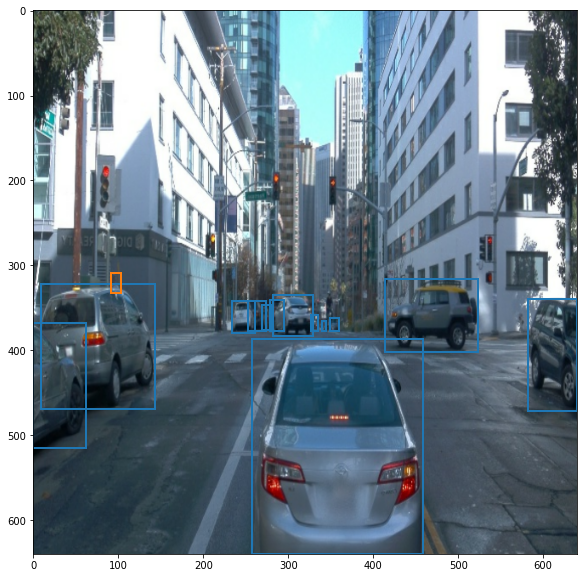

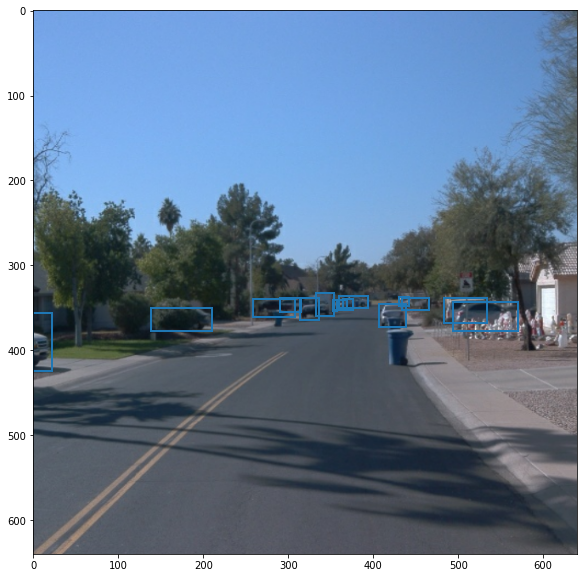

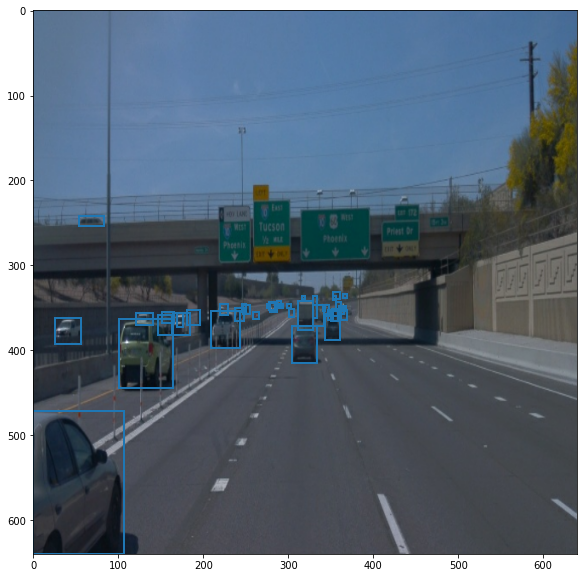

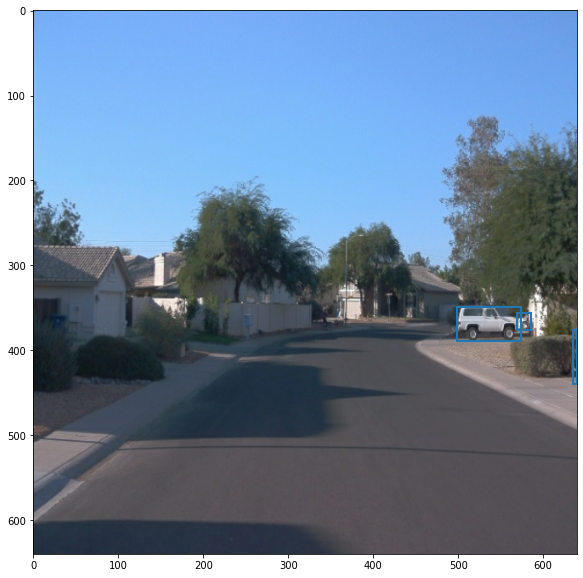

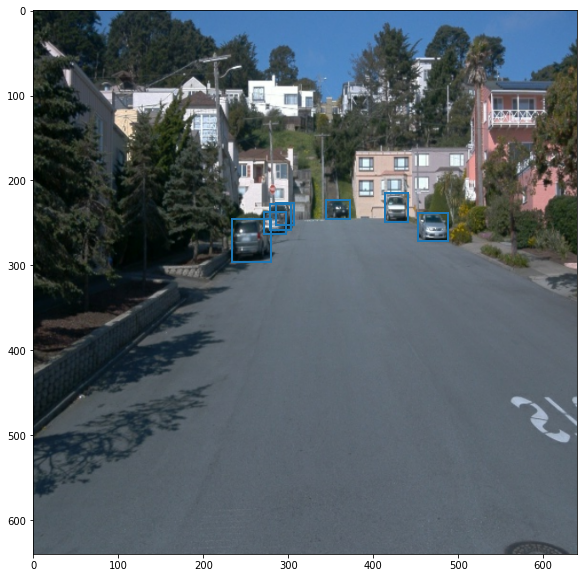

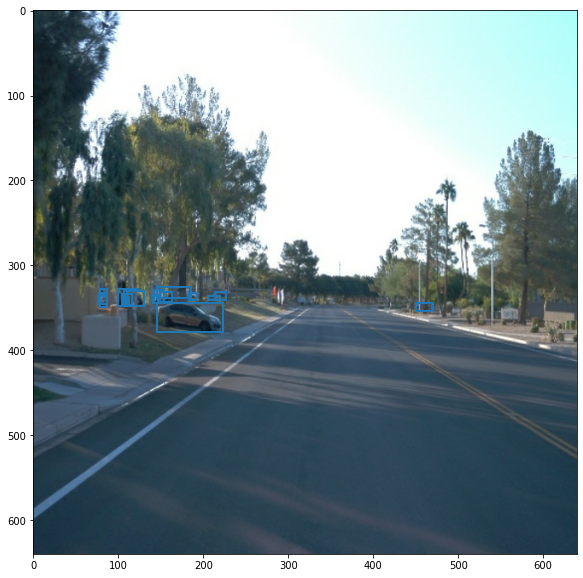

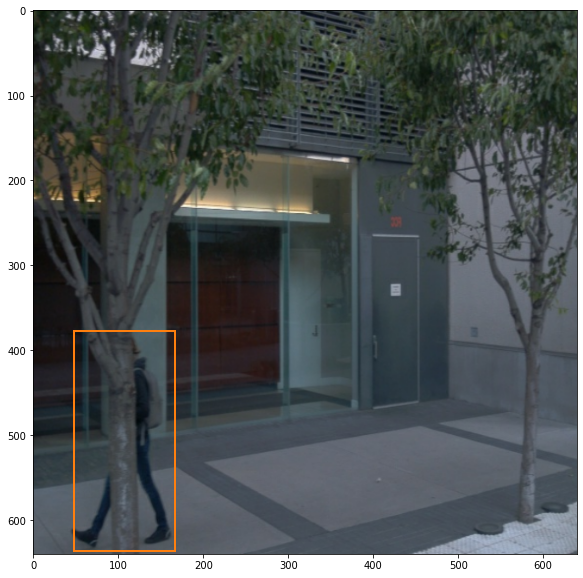

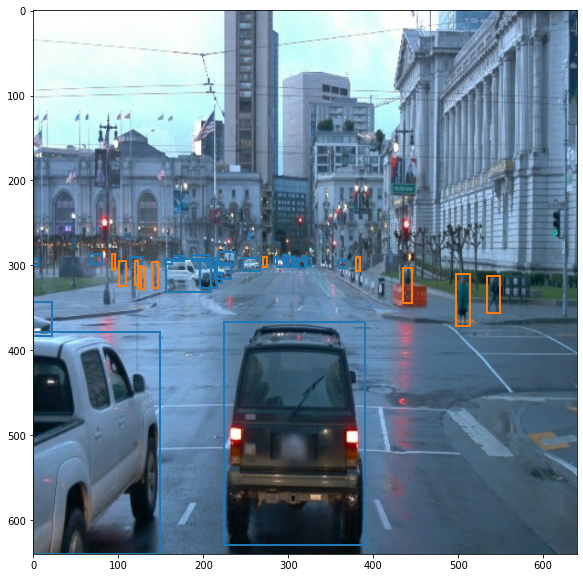

In [4]:
%matplotlib inline

# take a set of sample batches and apply augmention as specified in the pipeline config
num_of_batches = 1
sample_batches = train_dataset.take(num_of_batches)
display_batch(sample_batches)

#### Experiment 0.06, 0.09

Use a customized configuration for data augmentation in the preprocessing step to be applied in the training pipeline of `ssd_resnet50_v1_fpn_keras` model with a set of additiona augmentation options. This includes the following TensorFlow standard augmentation methods:

- random horizontal flip
- random crop of an image section with variable aspect ratio and crop size
- random conversion of colorimages to grayscale
- random color distortion of brightness, saturation, hue and contrast
- random jitter of bounding box position and aspect ratio (e.g. to account for labeling errors)

See excerpt from [pipeline_experiment_0_06.config](./experiments/experiment_0_06/pipeline_experiment_0_06.config) below:

```
  data_augmentation_options {
    random_horizontal_flip {
    }
  }
  data_augmentation_options {
    random_crop_image {
      min_object_covered: 0.0
      min_aspect_ratio: 0.75
      max_aspect_ratio: 3.0
      min_area: 0.75
      max_area: 1.0
      overlap_thresh: 0.0
    }
  }
  data_augmentation_options {
    random_rgb_to_gray {
    }
  }
  data_augmentation_options {
    random_adjust_brightness {
      max_delta: 0.3
    }
  }
  data_augmentation_options {
    random_adjust_saturation {
      min_delta: 0.7
      max_delta: 1.3
    }
  }
  data_augmentation_options {
    random_adjust_hue {
      max_delta: 0.05
    }
  }
  data_augmentation_options {
    random_adjust_contrast {
      min_delta: 0.5
      max_delta: 1.5
    }
  }
  data_augmentation_options {
    random_jitter_boxes {
      ratio: 0.05
      jitter_mode: 0
    }
  }
```

In [5]:
train_dataset = get_train_input("./experiments/experiment_0_06/pipeline_experiment_0_06.config")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Number of filenames to read: 82
Instructions for updating:
keep_dims is deprecated, use keepdims instead



batch no.: 0	batch_size: 8	image format: (640, 640, 3)


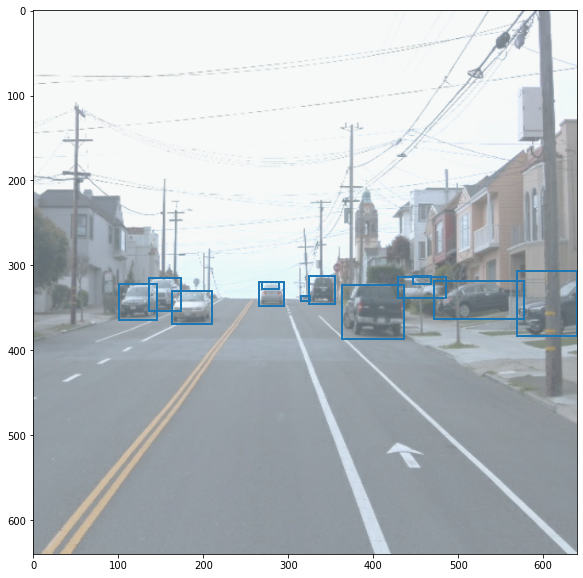

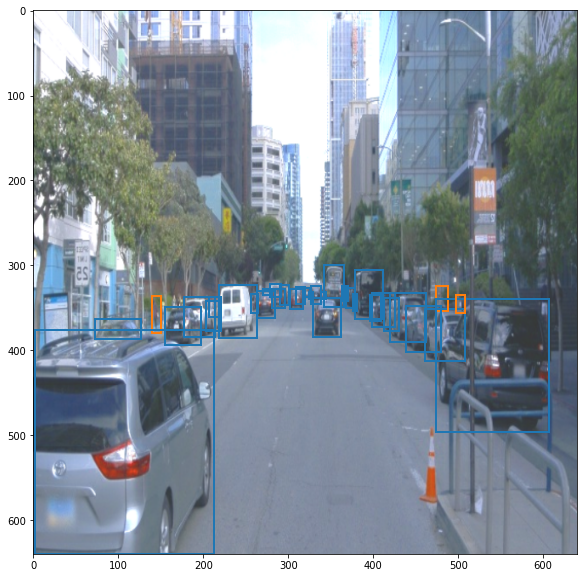

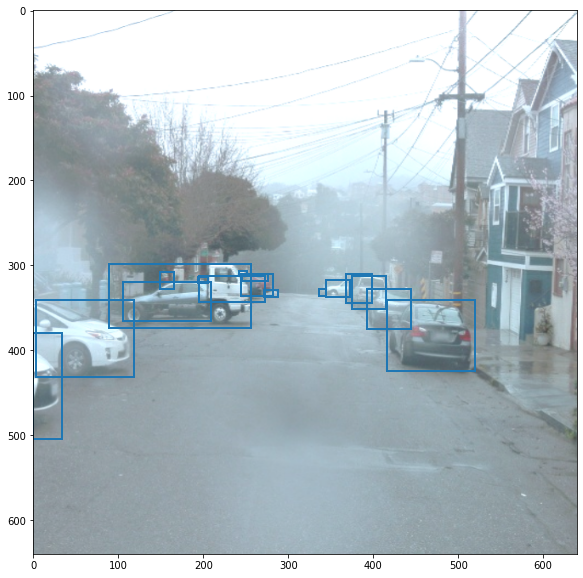

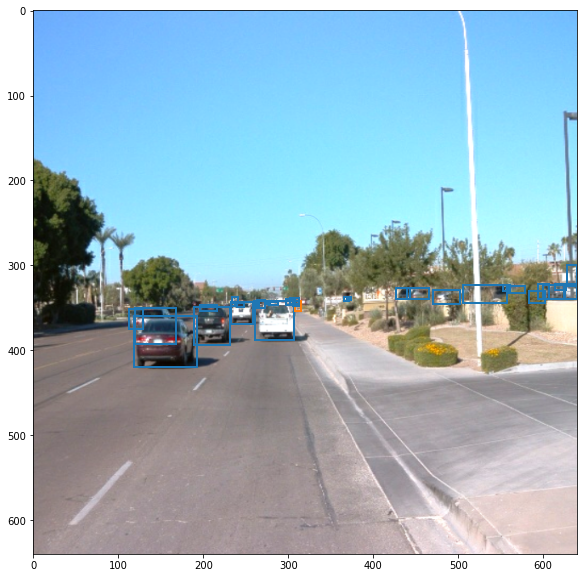

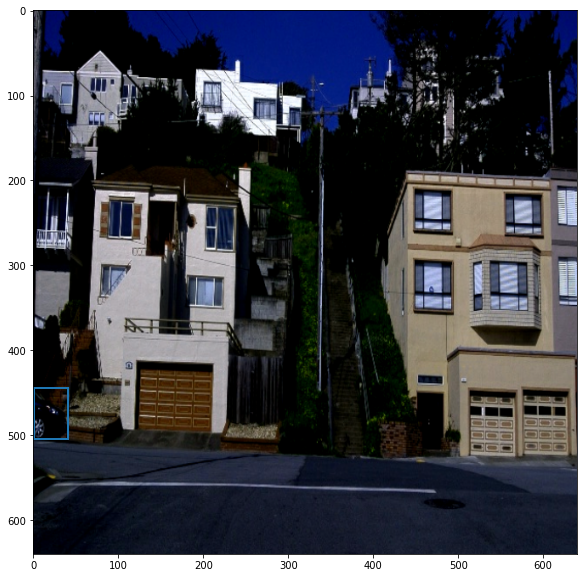

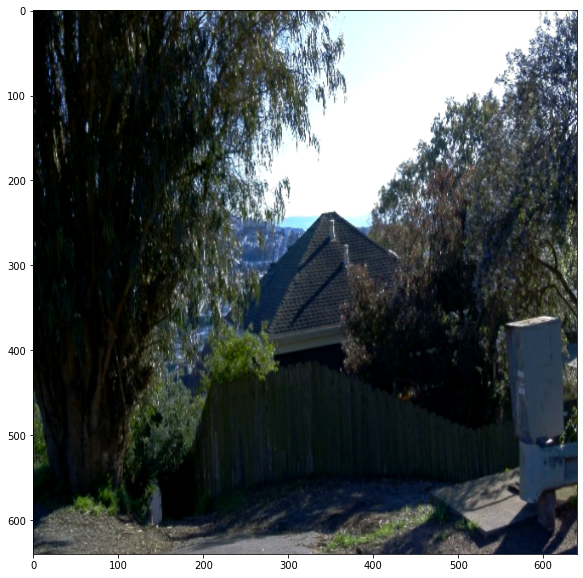

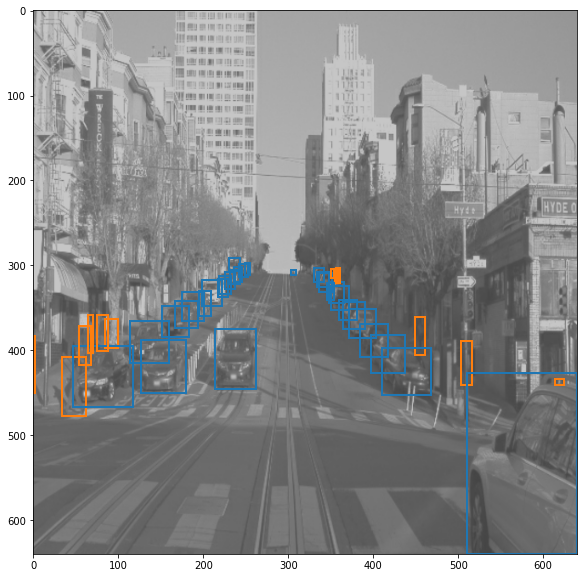

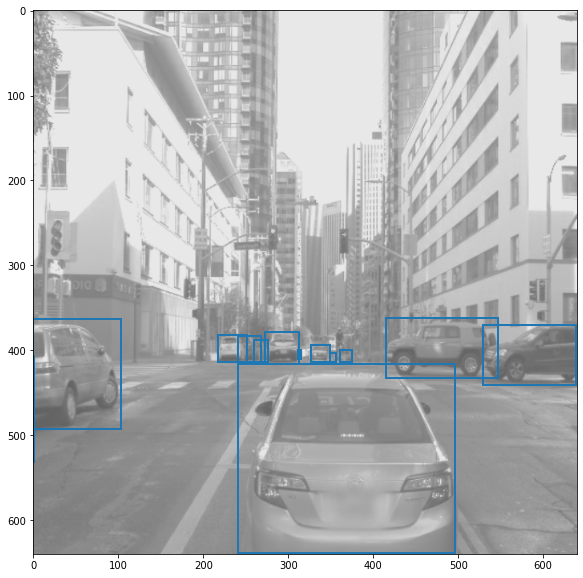

In [6]:
%matplotlib inline

# take a set of sample batches and apply augmention as specified in the pipeline config
num_of_batches = 1
sample_batches = train_dataset.take(num_of_batches)
display_batch(sample_batches)

#### Experiment 0.07

Use a customized configuration for data augmentation in the preprocessing step to be applied in the training pipeline of `ssd_resnet50_v1_fpn_keras` model with a set of additiona augmentation options. This includes the following TensorFlow standard augmentation methods:

- random horizontal flip
- random crop of an image section with variable aspect ratio and crop size
- random conversion of colorimages to grayscale
- random color distortion of brightness, saturation, hue and contrast (ensure that pixel values stay within 0...255)
- random jitter of bounding box position and aspect ratio (e.g. to account for labeling errors)

See excerpt from [pipeline_experiment_0.07.config](./experiments/experiment_0_07/pipeline_experiment_0_07.config) below:

```
  data_augmentation_options {
    random_horizontal_flip {
    }
  }
  data_augmentation_options {
    random_crop_image {
      min_object_covered: 0.0
      min_aspect_ratio: 0.75
      max_aspect_ratio: 3.0
      min_area: 0.75
      max_area: 1.0
      overlap_thresh: 0.0
    }
  }
  data_augmentation_options {
    random_rgb_to_gray {
    }
  }
  data_augmentation_options {
    random_distort_color {
      color_ordering: 0
    }
  }
  data_augmentation_options {
    random_jitter_boxes {
      ratio: 0.05
    }
  }
```

In [7]:
train_dataset = get_train_input("./experiments/experiment_0_07/pipeline_experiment_0_07.config")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Number of filenames to read: 82



batch no.: 0	batch_size: 8	image format: (640, 640, 3)


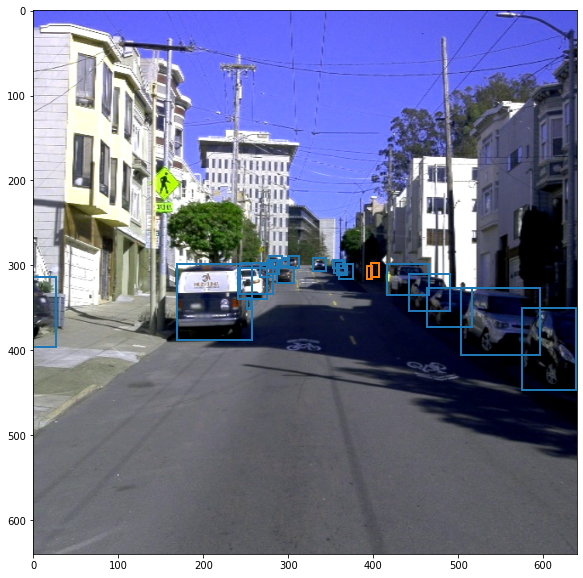

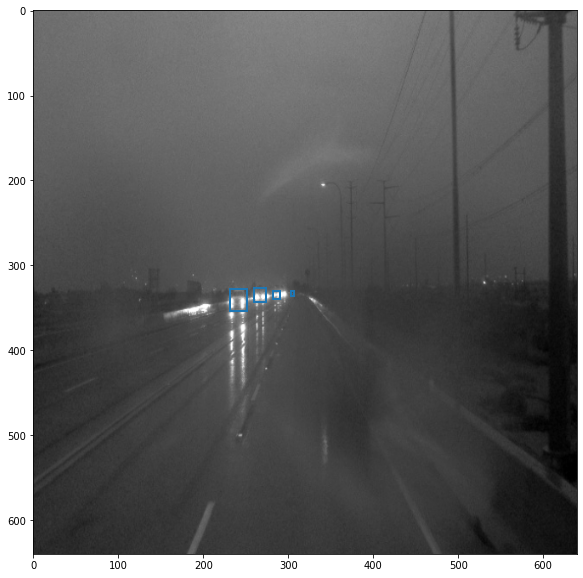

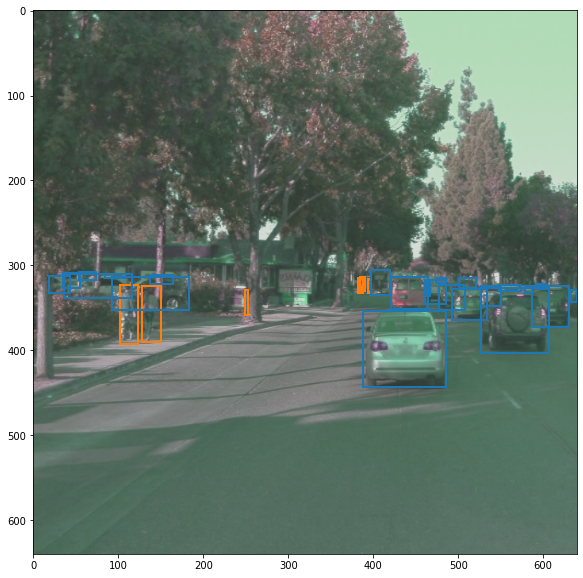

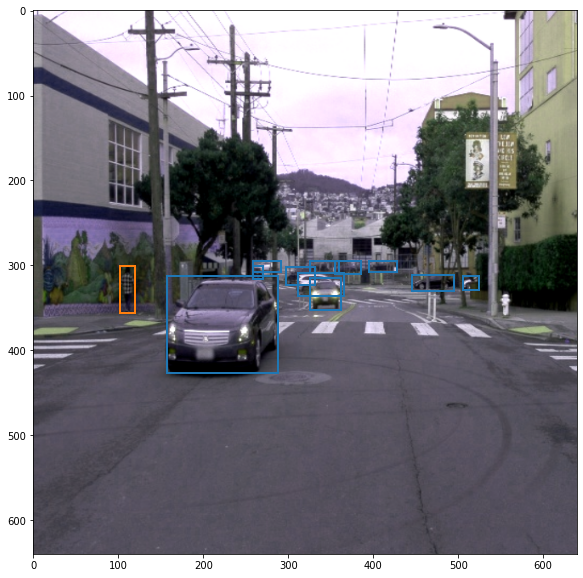

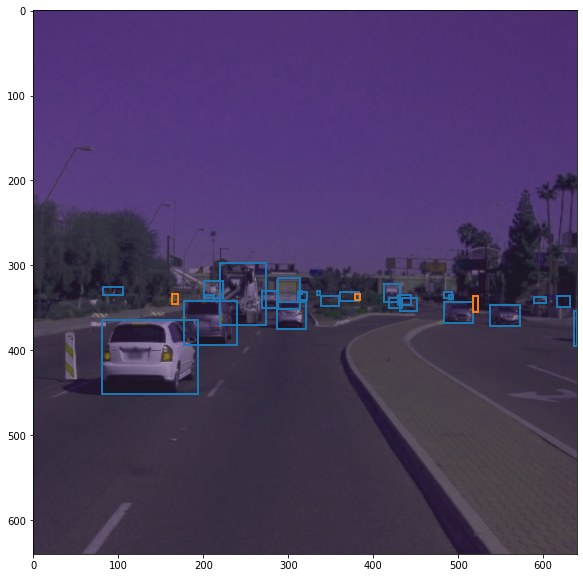

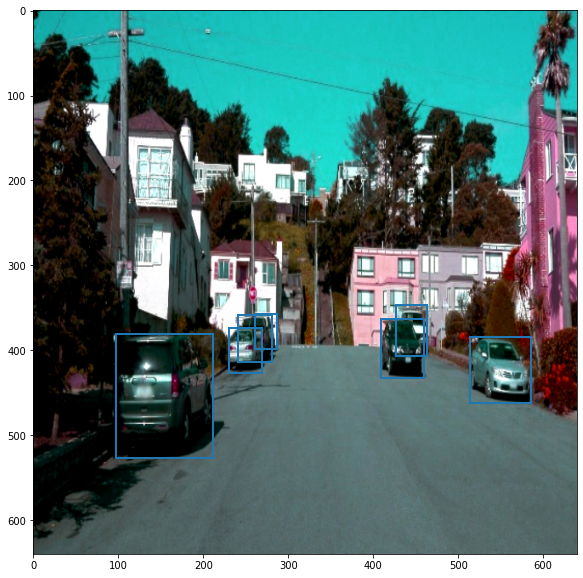

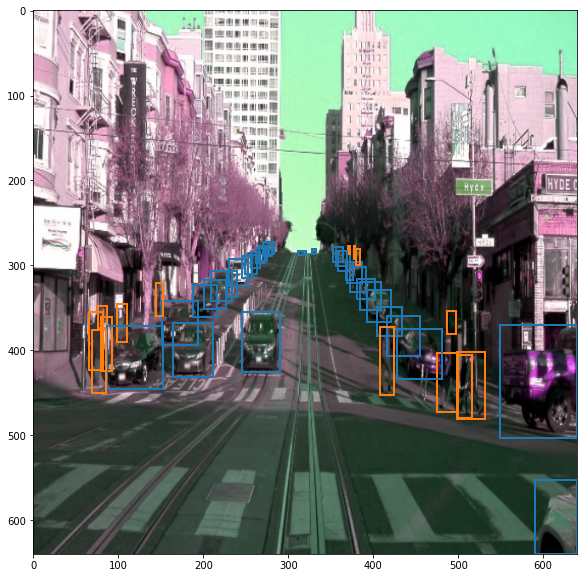

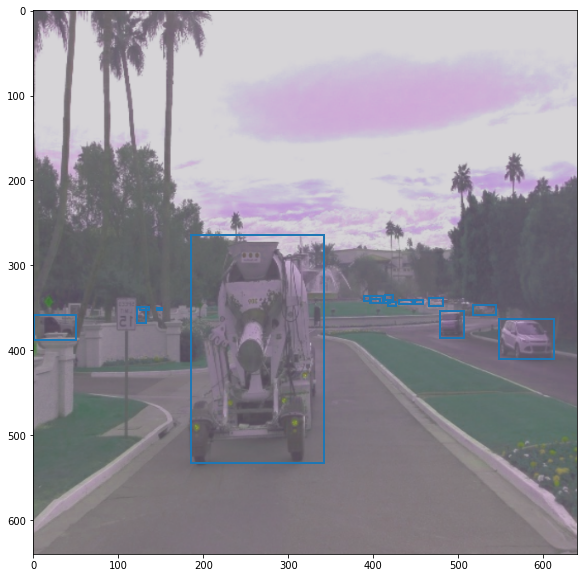

In [8]:
%matplotlib inline

# take a set of sample batches and apply augmention as specified in the pipeline config
num_of_batches = 1
sample_batches = train_dataset.take(num_of_batches)
display_batch(sample_batches)

#### Experiment 0.08

Use a customized configuration for data augmentation in the preprocessing step to be applied in the training pipeline of `ssd_resnet50_v1_fpn_keras` model with a set of additiona augmentation options. This includes the following TensorFlow standard augmentation methods:

- random horizontal flip
- random vertical flip
- random rotation of 90, 180 and 270 degrees
- random crop of an image section with variable aspect ratio and crop size

See excerpt from [pipeline_experiment_0_08.config](./experiments/experiment8/pipeline_experiment_0_08.config) below:

```
  data_augmentation_options {
    random_horizontal_flip {
    }
  }
  data_augmentation_options {
    random_vertical_flip {
    }
  }
  data_augmentation_options {
    random_rotation90 {
    }
  }
  data_augmentation_options {
    random_rotation90 {
    }
  }
  data_augmentation_options {
    random_rotation90 {
    }
  }
  data_augmentation_options {
    random_crop_image {
      min_object_covered: 0.0
      min_aspect_ratio: 0.75
      max_aspect_ratio: 3.0
      min_area: 0.75
      max_area: 1.0
      overlap_thresh: 0.0
    }
  }
```

In [9]:
train_dataset = get_train_input("./experiments/experiment_0_08/pipeline_experiment_0_08.config")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Number of filenames to read: 82



batch no.: 0	batch_size: 8	image format: (640, 640, 3)


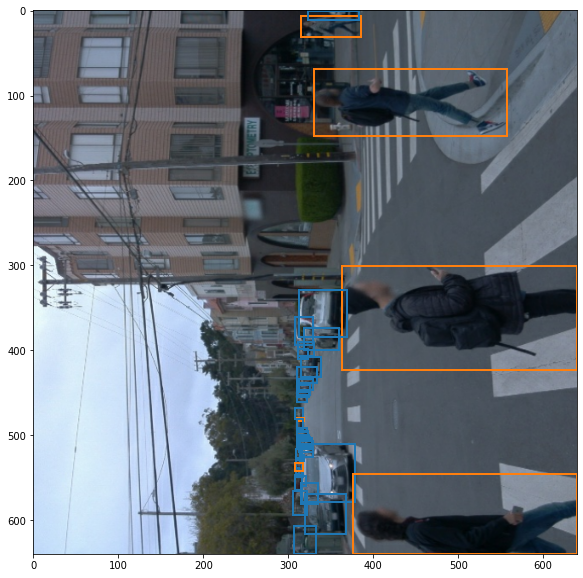

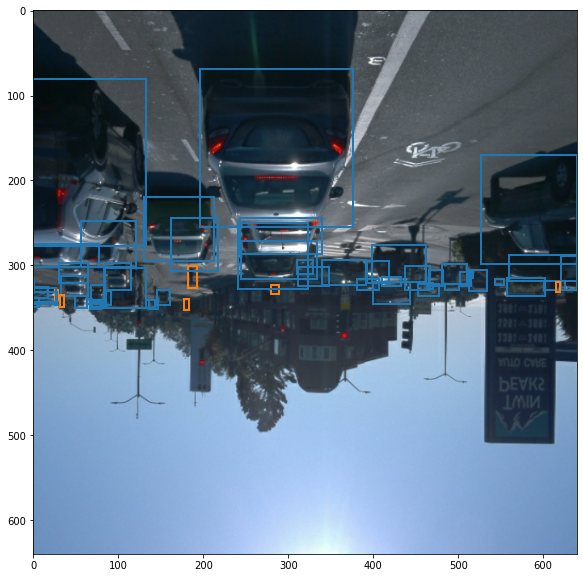

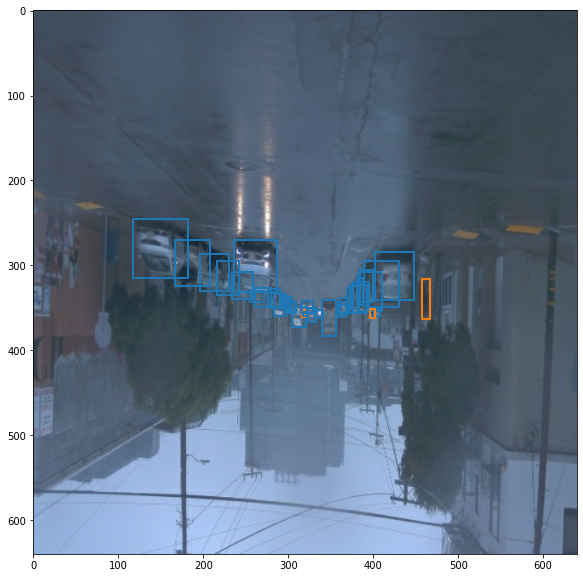

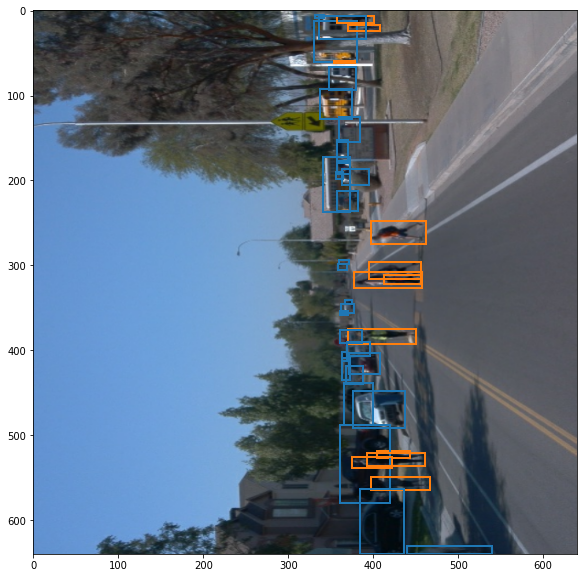

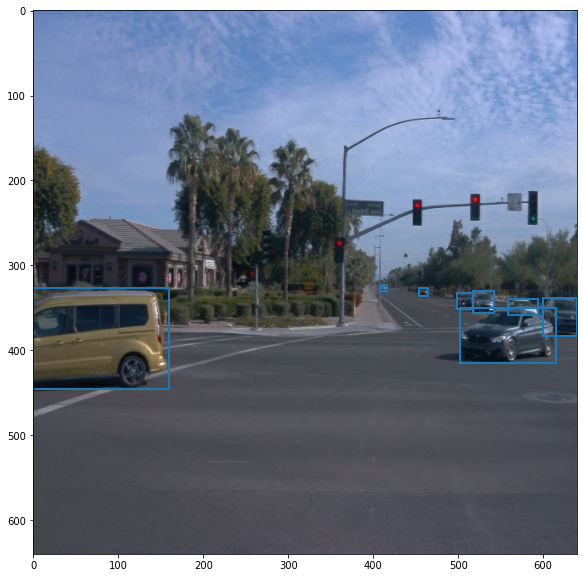

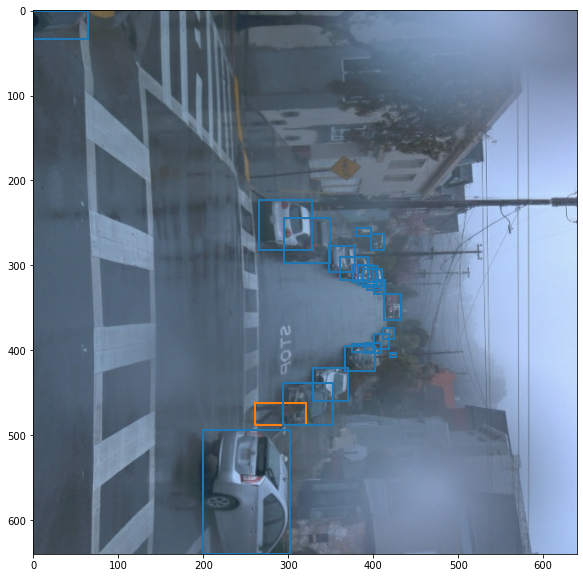

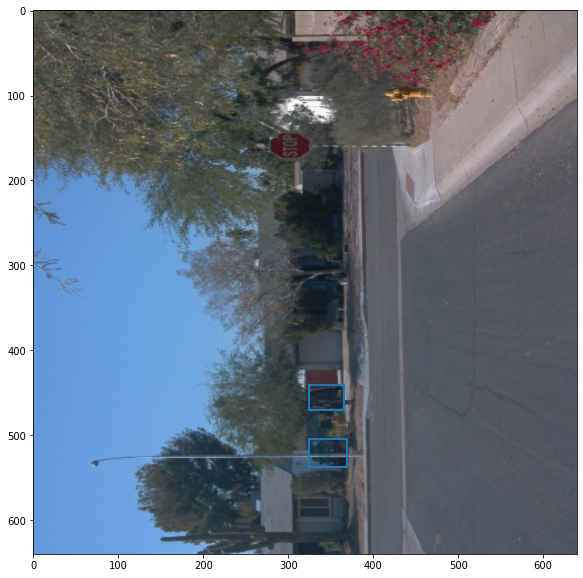

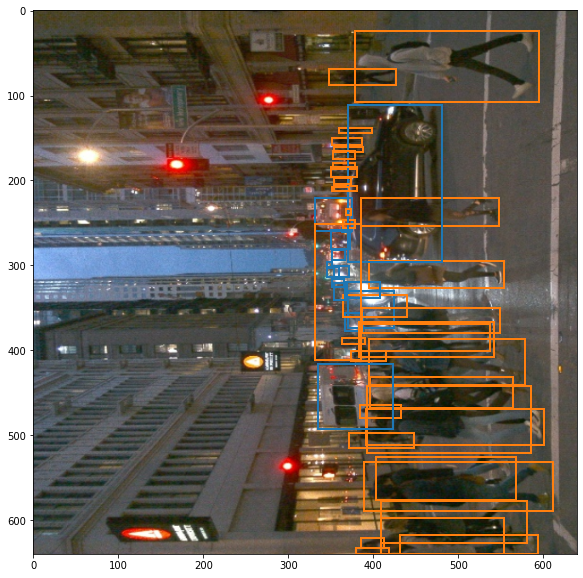

In [10]:
%matplotlib inline

# take a set of sample batches and apply augmention as specified in the pipeline config
num_of_batches = 1
sample_batches = train_dataset.take(num_of_batches)
display_batch(sample_batches)

#### Experiment 1.00 & 1.01

Experiments 1.00, 1.01 and 1.02 are based on `ssd_efficientnet-b1_bifpn_keras`. This feature extractor model uses a different target input format and a different image preprocessing than `ssd_resnet50_v1_fpn_keras`. Therefore, we also need an different method in order to approximately revert the image normalization effects of the preprocessing pipeline on the RGB color values.

Experiment 1.00 and 1.01 are done using the default augmentation options of `ssd_efficientnet-b1_bifpn_keras`. It comes with the following TensorFlow standard augmentation options set in the pipeline.config file:

- random horizontal flip
- random scale the image between a minimum and a maximum scale factor
- random crop an image section with variable aspect ratio and crop size
- finally pad crop to a given square format

See excerpt from [pipeline_experiment_1_00.config](./experiments/experiment_1_00/pipeline_experiment_1_00.config) below:

```
  data_augmentation_options {
    random_horizontal_flip {
    }
  }
  data_augmentation_options {
    random_scale_crop_and_pad_to_square {
      output_size: 640
      scale_min: 0.10000000149011612
      scale_max: 2.0
    }
  }
```

In [11]:
train_dataset = get_train_input("./experiments/experiment_1_00/pipeline_experiment_1_00.config")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Number of filenames to read: 82


INFO:tensorflow:Number of filenames to read: 82



batch no.: 0	batch_size: 8	image format: (640, 640, 3)


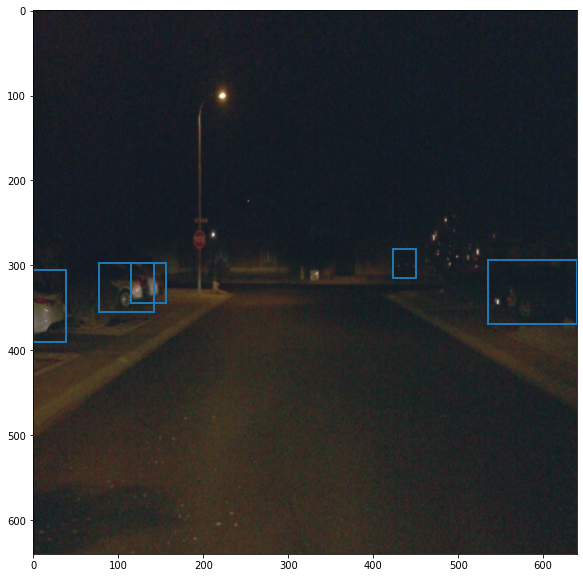

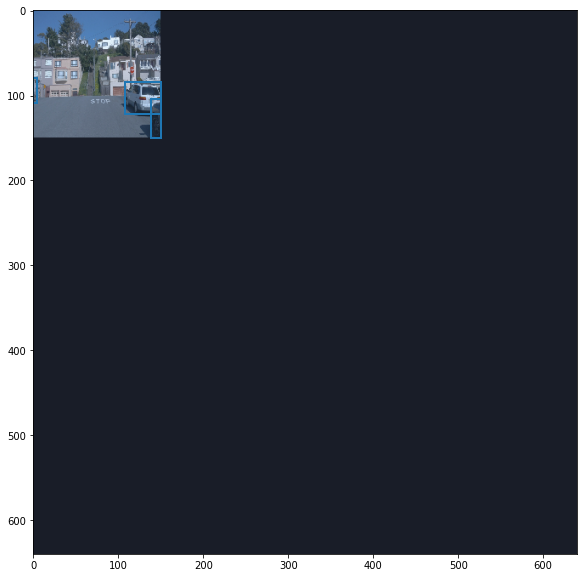

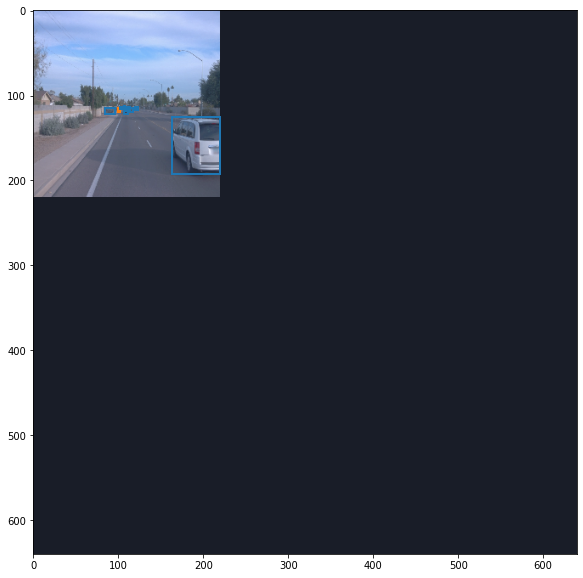

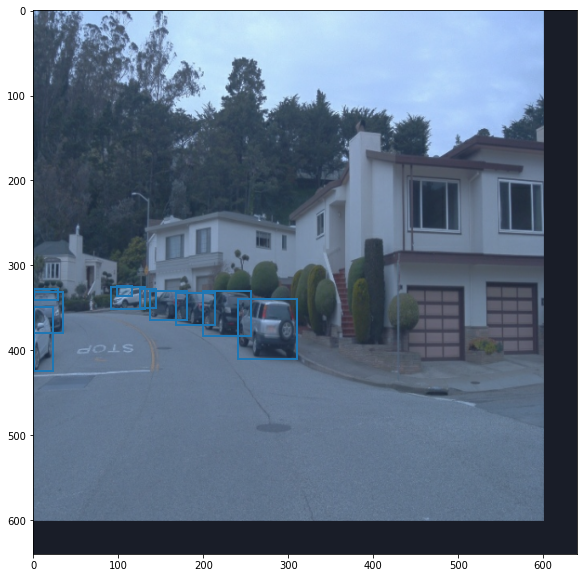

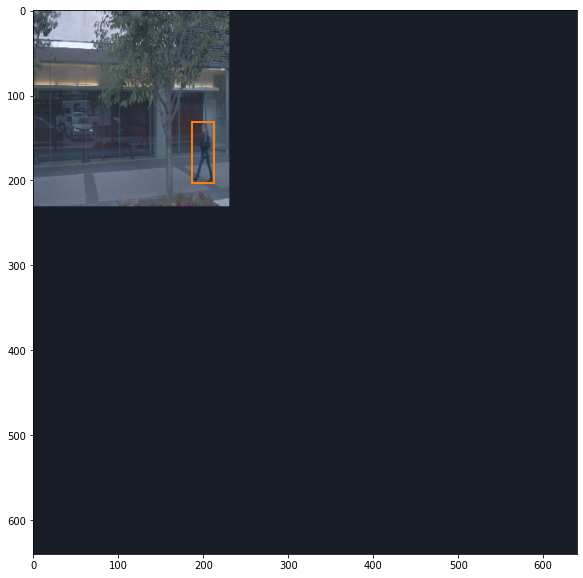

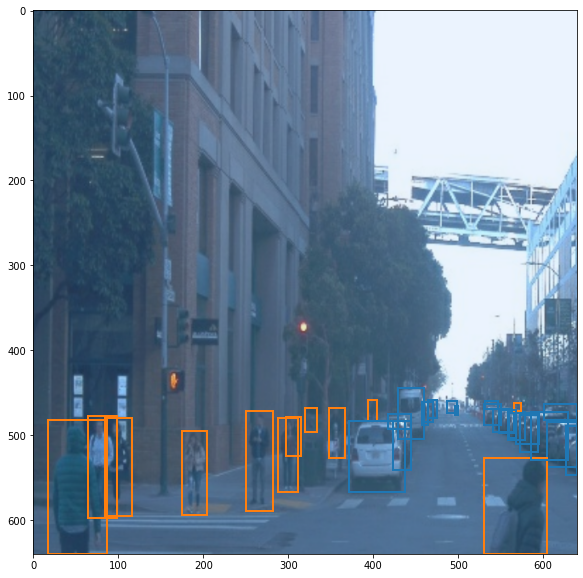

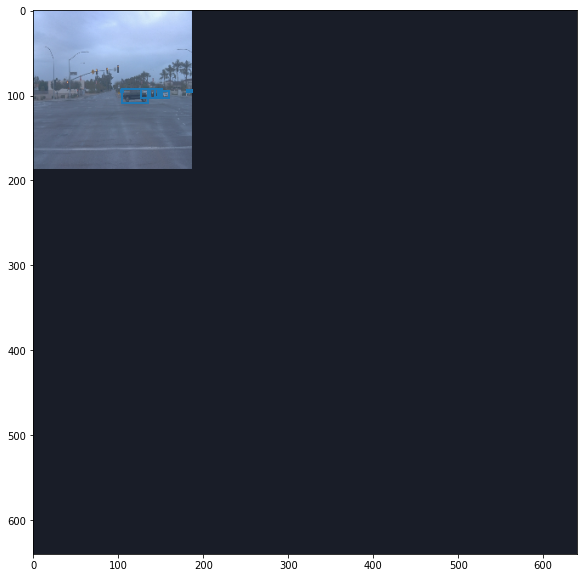

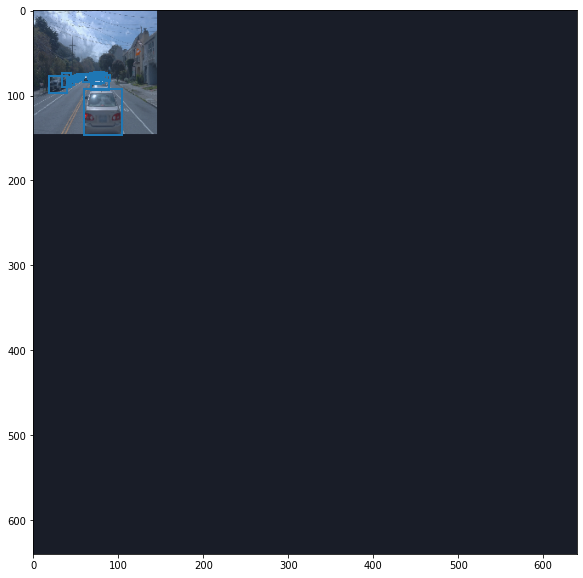

In [12]:
%matplotlib inline

# take a set of sample batches and apply augmention as specified in the pipeline config
num_of_batches = 1
sample_batches = train_dataset.take(num_of_batches)
display_batch(sample_batches, feature_extractor_type='ssd_efficientnet-b1_bifpn_keras')

#### Experiment 1.02

Experiments 1.00, 1.01 and 1.02 are based on `ssd_efficientnet-b1_bifpn_keras`. This model requires a different target input format than `ssd_resnet50_v1_fpn_keras`. The simple recenter_image() method does not work here any more, and thus, we obtain brownish colored images when applying the configured augmentation methods in the preprocessing step and then recentering the obtained images.

The following TensorFlow standard augmentation options are configured for experiment 1.02:

- random horizontal flip
- random crop of an image section with variable aspect ratio and crop size
- random conversion of colorimages to grayscale
- random color distortion of brightness, saturation, hue and contrast
- random jitter of bounding box position and aspect ratio (e.g. to account for labeling errors)

See excerpt from [pipeline_experiment_1_02.config](./experiments/experiment_0_06/pipeline_experiment_1_02.config) below:

```
  data_augmentation_options {
    random_horizontal_flip {
    }
  }
  data_augmentation_options {
    random_scale_crop_and_pad_to_square {
      output_size: 640
      scale_min: 0.10000000149011612
      scale_max: 2.0
    }
  }
  data_augmentation_options {
    random_rgb_to_gray {
    }
  }
  data_augmentation_options {
    random_adjust_brightness {
      max_delta: 0.3
    }
  }
  data_augmentation_options {
    random_adjust_saturation {
      min_delta: 0.7
      max_delta: 1.3
    }
  }
  data_augmentation_options {
    random_adjust_hue {
      max_delta: 0.05
    }
  }
  data_augmentation_options {
    random_adjust_contrast {
      min_delta: 0.5
      max_delta: 1.5
    }
  }
  data_augmentation_options {
    random_jitter_boxes {
      ratio: 0.05
      jitter_mode: 0
    }
  }
```

In [13]:
train_dataset = get_train_input("./experiments/experiment_1_02/pipeline_experiment_1_02.config")

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading unweighted datasets: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_camera_labels

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Reading record datasets for input file: ['/app/project/data/waymo/train/segment-11379226583756500423_6230_810_6250_810_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11388947676680954806_5427_320_5447_320_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11718898130355901268_2300_000_2320_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10485926982439064520_4980_000_5000_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10153695247769592104_787_000_807_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11967272535264406807_580_000_600_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10625026498155904401_200_000_220_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-11355519273066561009_5323_000_5343_000_with_camera_labels.tfrecord', '/app/project/data/waymo/train/segment-10206293520369375008_2796_800_2816_800_with_ca

INFO:tensorflow:Number of filenames to read: 82


INFO:tensorflow:Number of filenames to read: 82



batch no.: 0	batch_size: 8	image format: (640, 640, 3)


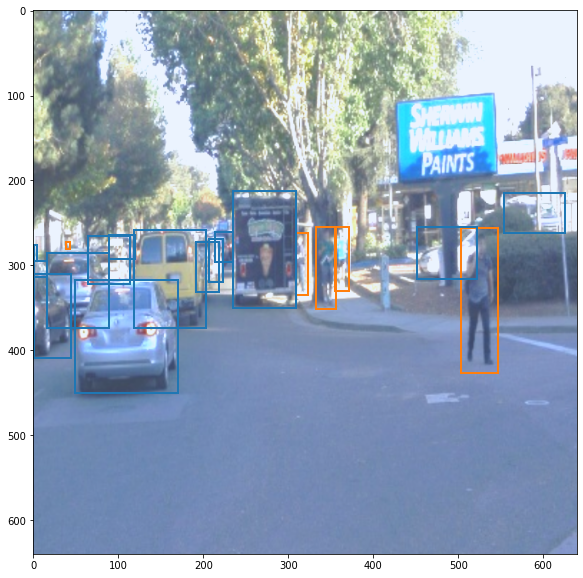

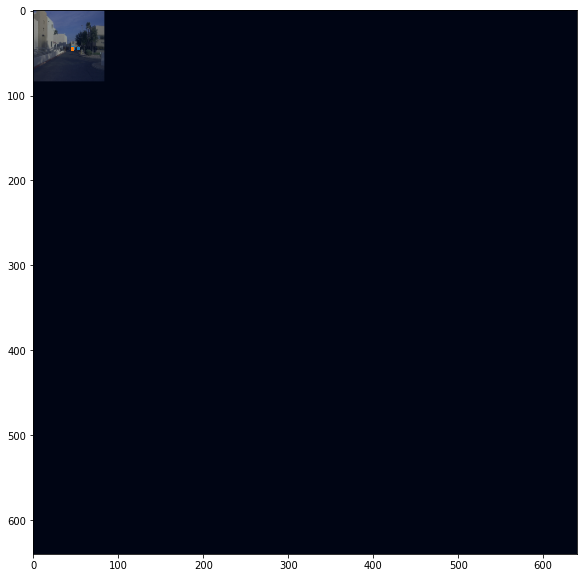

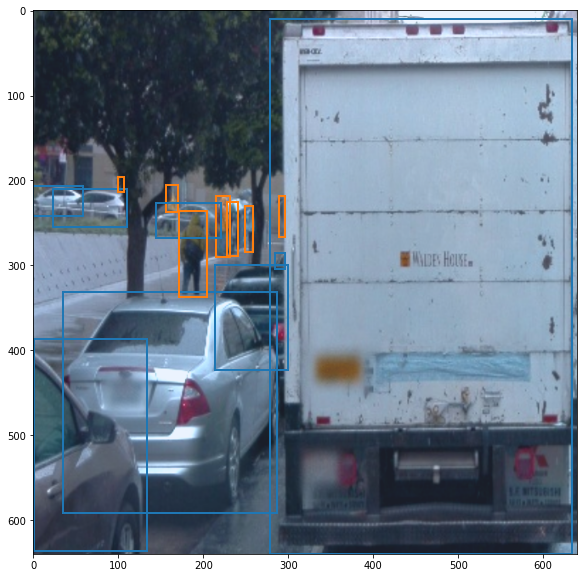

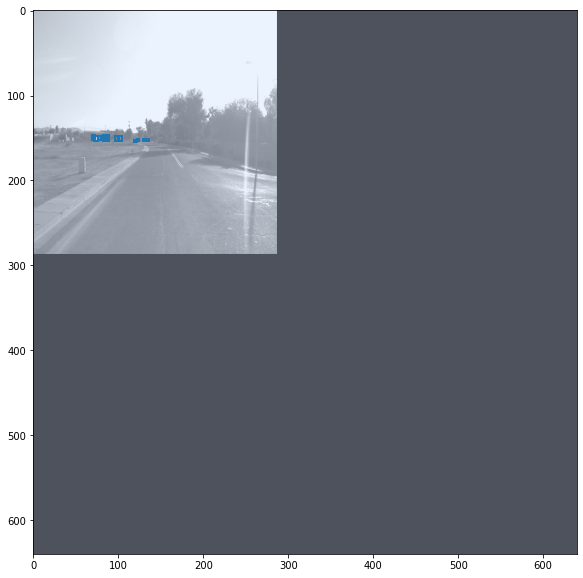

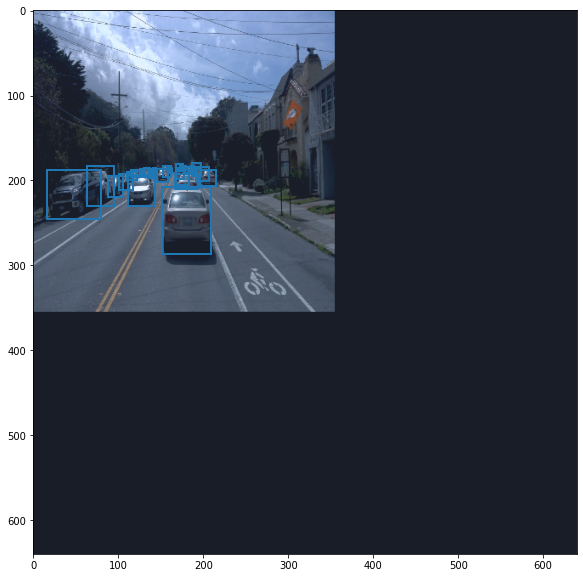

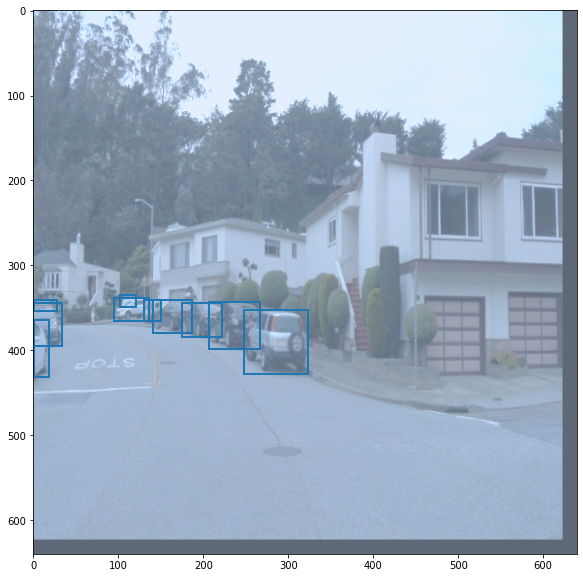

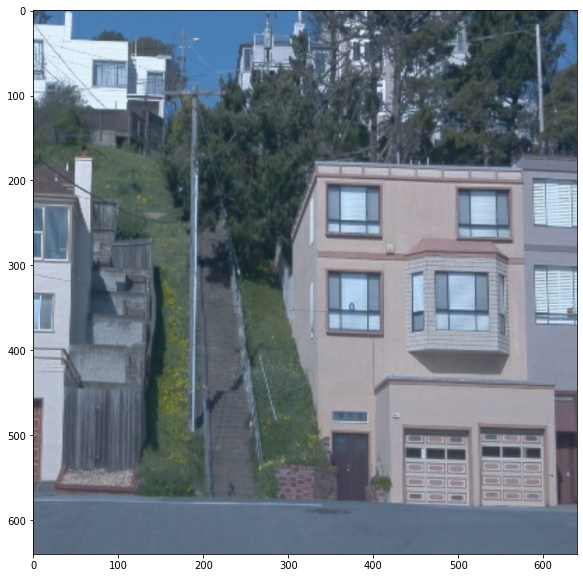

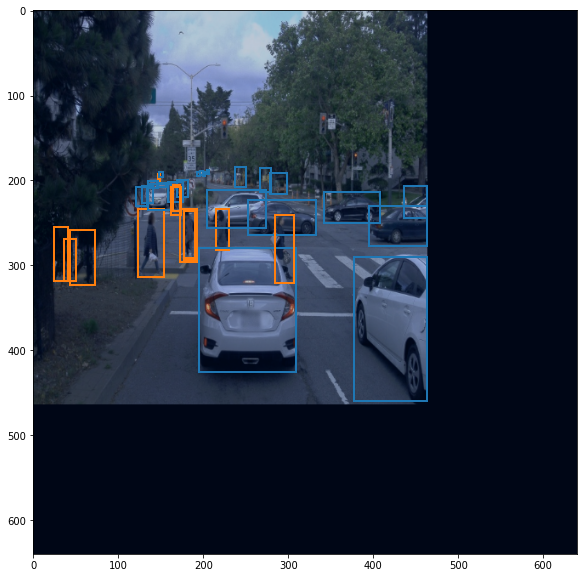

In [14]:
%matplotlib inline

# take a set of sample batches and apply augmention as specified in the pipeline config
num_of_batches = 1
sample_batches = train_dataset.take(num_of_batches)
display_batch(sample_batches, feature_extractor_type='ssd_efficientnet-b1_bifpn_keras')